*To ensure clarity and allow readers to run each section independently, each code section includes all necessary steps such as loading the dataset.*

# Motivation
This project aims to explores how factors like timing, location, and industry relate to business survival in San Francisco. I used the "Registered Business Locations – San Francisco" dataset, which offers rich spatial, temporal, and industry-specific information. I chose this dataset because it not only covers a wide range of business types over a long period of time, but also includes valuable details like business start and end dates, neighborhoods, and industry classifications — all of which are essential for understanding patterns of survival. I hoped to encourage exploration by combining interactive and static charts. Ideally, the end user walks away not just with facts, but with a better feel for how timing, location, and industry shape the business landscape in San Francisco.

In [3]:
import pandas as pd

# Load the original CSV file
df = pd.read_csv("//Users//yst//Documents//02806//project//Registered_Business_Locations_-_San_Francisco_20250410.csv")

# Keep only relevant fields for analysis
columns_to_keep = [
    "UniqueID",                              # Unique business ID
    "Business Account Number",              # Account number
    "Business Start Date",                  # Opening date
    "Business End Date",                    # Closing date
    "NAICS Code Description",              # Industry category
    "Neighborhoods - Analysis Boundaries", # Neighborhood info
    "Supervisor District",                 # Supervisor district
    "Street Address",                      # Address for tooltip display
    "Business Location"                    # Coordinates (latitude, longitude)
]

df = df[columns_to_keep].copy()

# Convert date fields to datetime format
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"], errors="coerce")
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors="coerce")

# calculate lifespan
df["end_date"] = df["Business End Date"].fillna(pd.to_datetime("2025-01-01"))
df["lifespan_years"] = (df["end_date"] - df["Business Start Date"]).dt.days / 365.25

# Extract start from dates
df["Start Year"] = df["Business Start Date"].dt.year
df["End Year"] = df["Business End Date"].dt.year

# Filter businesses that started between 2003 and 2025
df_filtered = df[(df["Start Year"] >= 2003) & (df["Start Year"] <= 2025)].copy()

# Check the number of rows in the dataset
print("Total number of rows:", len(df_filtered))
print("Shape:", df.shape)
print("Missing values:\n", df.isna().sum())
print(df["lifespan_years"].describe())
print("Top industries:\n", df["NAICS Code Description"].value_counts().head())
print("Top neighborhoods:\n", df["Neighborhoods - Analysis Boundaries"].value_counts().head())
print("Top start years:\n", df["Start Year"].value_counts().head())

# Save the cleaned dataset to a new CSV file
df_filtered.to_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv", index=False)

Total number of rows: 282160
Shape: (339726, 13)
Missing values:
 UniqueID                                    0
Business Account Number                     0
Business Start Date                         0
Business End Date                      161574
NAICS Code Description                 158293
Neighborhoods - Analysis Boundaries     64667
Supervisor District                     64648
Street Address                             16
Business Location                        1163
end_date                                    0
lifespan_years                              0
Start Year                                  0
End Year                               161574
dtype: int64
count    339726.000000
mean         10.911026
std          11.812199
min          -0.268309
25%           2.781656
50%           7.148528
75%          14.507871
max         176.002738
Name: lifespan_years, dtype: float64
Top industries:
 NAICS Code Description
Professional, Scientific, and Technical Services    29066
Real

# Basic stats
To prepare the dataset for analysis, I selected businesses that started between 2003 and 2025 and retained fields relevant to survival trends, which including start/end dates, industry category, and neighborhood location. After cleaning and preprocessing, the dataset contained 282,160 records with valid registration dates.
Several key characteristics emerged:

**Start Dates**

Most businesses were registered between 2014 and 2018, with 2016 having the highest number of new entries. These years are featured in the line chart to explore how registration and closure trends evolved over time.

**End Dates**

Many businesses have no recorded end date, indicating they may still be active. To standardize lifespan calculations, these were filled with January 1, 2025, allowing all entries to be included in lifespan-related visualizations.

**Business Lifespan**

The average lifespan was about 10.9 years, but the distribution varied widely, some lasted over 100 years, while many survived fewer than 3 years. This metric underpins multiple visualizations, including scatter plots, choropleth maps, and bar charts.

**Industry Distribution**

The most common industries included Professional, Scientific, and Technical Services, Real Estate, and Construction. These industry labels were used to compare lifespan variation in both the interactive scatterplot and the bar chart of long-lived businesses.

**Neighborhoods**

Neighborhood information was missing for about 64,000 entries, but among the rest, areas like Financial District/South Beach and Mission had the highest number of businesses. This data was used in two choropleth maps to explore spatial trends in density and longevity.

Overall, this cleaned dataset provided a strong foundation for prediction and exploring how time, location, and industry each relate to business survival.

In [5]:
import pandas as pd
import plotly.graph_objects as go

# Load dataset
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")

# Convert to datetime
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"], errors='coerce')
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors='coerce')

# Extract start and end years
df["Start Year"] = df["Business Start Date"].dt.year
df["End Year"] = df["Business End Date"].dt.year

# Count number of new and closed businesses per year
start_counts = df["Start Year"].value_counts().sort_index()
end_counts = df["End Year"].value_counts().sort_index()

# Create a line chart with two lines
fig = go.Figure()

# Line for new registrations
fig.add_trace(go.Scatter(
    x=start_counts.index,
    y=start_counts.values,
    mode='lines+markers',
    name='New Registrations',
    line=dict(color='blue')
))

# Line for closures
fig.add_trace(go.Scatter(
    x=end_counts.index,
    y=end_counts.values,
    mode='lines+markers',
    name='Business Closures',
    line=dict(color='lightblue')
))

# Customize layout
fig.update_layout(
    title='Yearly Business Registrations and Closures in San Francisco (2003–2025)',
    xaxis_title='Year',
    yaxis_title='Number of Businesses',
    hovermode='x unified',
    template='plotly_white',
    xaxis=dict(tickmode='linear', tick0=2003, dtick=1)  # show every year
)

# Save to HTML
fig.write_html("registrations_vs_closures.html")

# Show the chart
fig.show()

In [6]:
import pandas as pd
import plotly.express as px
import json

# Load dataset
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")

# Drop rows without neighborhood info
df = df.dropna(subset=["Neighborhoods - Analysis Boundaries"])

# Count number of businesses per neighborhood
neighborhood_counts = df["Neighborhoods - Analysis Boundaries"].value_counts().reset_index()
neighborhood_counts.columns = ["Neighborhood", "Business Count"]

# Load GeoJSON with neighborhood boundaries
with open("//Users//yst//Documents//02806//project//Analysis Neighborhoods_20250426.geojson") as f:
    geojson = json.load(f)

# Plotly choropleth map showing business density
fig = px.choropleth_mapbox(
    neighborhood_counts,
    geojson=geojson,
    locations="Neighborhood",
    featureidkey="properties.nhood",
    color="Business Count",
    color_continuous_scale="Oranges",
    mapbox_style="carto-positron",
    zoom=10,
    center={"lat": 37.76, "lon": -122.45},
    opacity=0.7,
    labels={"Business Count": "Number of Businesses"}
)

# Layout settings
fig.update_layout(
    title="Business Density by Neighborhood (2003–2025)",
    margin={"r":0,"t":40,"l":0,"b":0}
)

# Save to HTML
fig.write_html("neighborhood_density.html")

# Show the map
fig.show()

In [7]:
import pandas as pd
import plotly.express as px
import json

# Load dataset
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")

# Convert date columns to datetime
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"])
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors="coerce")

# Fill NA end dates with 2025-01-01 to assume still active
df["end_date"] = df["Business End Date"].fillna(pd.to_datetime("2025-01-01"))

# Calculate lifespan in years
df["lifespan_years"] = (df["end_date"] - df["Business Start Date"]).dt.days / 365.25

# Group by neighborhood and calculate average lifespan
lifespan_by_neighborhood = df.groupby("Neighborhoods - Analysis Boundaries")["lifespan_years"].mean().reset_index()

# Rename columns for easier mapping
lifespan_by_neighborhood.columns = ["neighborhood", "avg_lifespan"]

# Load GeoJSON boundary file
with open("//Users//yst//Documents//02806//project//Analysis Neighborhoods_20250426.geojson") as f:
    geojson = json.load(f)

# Create Choropleth map using Plotly
fig = px.choropleth_mapbox(
    lifespan_by_neighborhood,
    geojson=geojson,
    locations="neighborhood",               # Match to feature.id in GeoJSON
    featureidkey="properties.nhood", 
    color="avg_lifespan",                   # Color based on average lifespan
    color_continuous_scale="Viridis",
    mapbox_style="carto-positron",
    center={"lat": 37.76, "lon": -122.45},  # Centered on SF
    zoom=10,
    opacity=0.7,
    labels={"avg_lifespan": "Avg Lifespan (yrs)"},
    hover_name="neighborhood",  
    hover_data={"avg_lifespan": True}
)

# Set the title
fig.update_layout(
    title="Average Business Lifespan by Neighborhood (2003–2025)",
    margin={"r":0,"t":40,"l":0,"b":0}
)

# Save the figure to HTML
fig.write_html("business_lifespan_by_neighborhood.html")

fig.show()

In [8]:
import pandas as pd
from bokeh.models import ColumnDataSource, Select, CustomJS
from bokeh.io import output_notebook, show, output_file, save
from bokeh.layouts import column
from bokeh.transform import jitter
from bokeh.plotting import figure
from bokeh.io import reset_output

reset_output()

# Load dataset
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")

# Convert dates
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"], errors='coerce')
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors='coerce')
df["end_date"] = df["Business End Date"].fillna(pd.to_datetime("2025-01-01"))

# Calculate lifespan in years
df["lifespan_years"] = (df["end_date"] - df["Business Start Date"]).dt.days / 365.25

# Filter necessary columns
df = df[["NAICS Code Description", "lifespan_years"]].dropna()

# Keep industries with enough data
industry_counts = df["NAICS Code Description"].value_counts()
industries = industry_counts[industry_counts > 50].index.tolist()

# Initial industry
initial_industry = industries[0]

# Prepare data source for JS
data_dict = {industry: df[df["NAICS Code Description"] == industry]["lifespan_years"].tolist()
             for industry in industries}

# Initial source (all x values are zero to enable jittering)
source = ColumnDataSource(data=dict(
    x=[0] * len(data_dict[initial_industry]),
    y=data_dict[initial_industry]
))

# Create figure
p = figure(title=f"Lifespan Distribution for {initial_industry}",
           width=700, height=400,
           y_axis_label="Lifespan (Years)",
           x_range=(-1, 1))  # Required for jitter to work

p.scatter(x=jitter('x', width=0.6, range=p.x_range), y='y',
          source=source, size=8, alpha=0.5)

# Dropdown menu
select = Select(title="Select Industry:", value=initial_industry, options=industries)

# JS callback
callback = CustomJS(args=dict(source=source, data_dict=data_dict, select=select, plot=p), code="""
    const industry = select.value;
    const y_data = data_dict[industry];
    const x_data = Array(y_data.length).fill(0);
    source.data = {x: x_data, y: y_data};
    source.change.emit();
    plot.title.text = "Lifespan Distribution for " + industry;
""")

select.js_on_change('value', callback)

layout = column(select, p)

# output_file("industry_lifespan.html")  
# save(layout)    
output_notebook()
show(layout)

Loading BokehJS ...

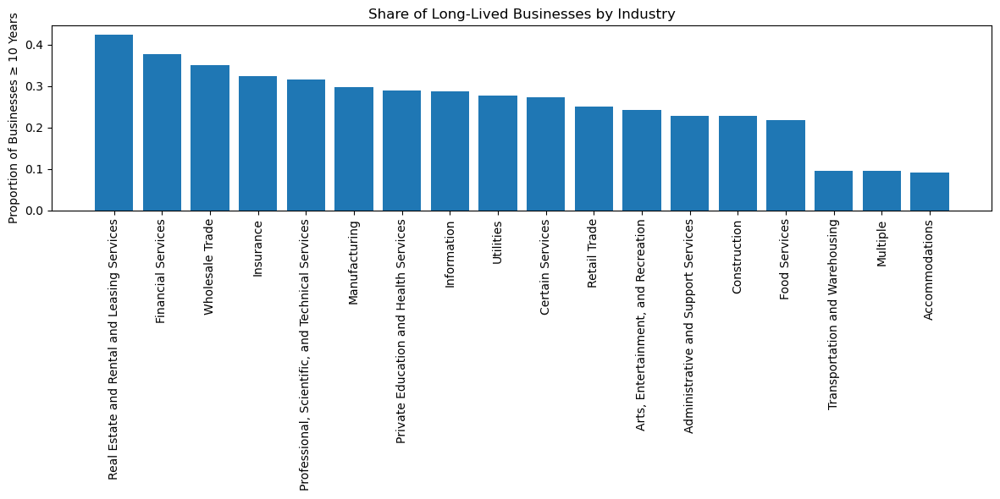

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")

# Convert date fields
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"], errors="coerce")
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors="coerce")
df["end_date"] = df["Business End Date"].fillna(pd.to_datetime("2025-01-01"))

# Calculate lifespan
df["lifespan_years"] = (df["end_date"] - df["Business Start Date"]).dt.days / 365.25

# Define threshold: consider 10+ years as "long-lived"
threshold = 10

# Group by industry
grouped = df.groupby("NAICS Code Description")

# Calculate long-lived rate
industry_stats = grouped["lifespan_years"].agg([
    ("total", "count"),
    ("long_lived", lambda x: (x >= threshold).sum())
])

industry_stats["long_lived_ratio"] = industry_stats["long_lived"] / industry_stats["total"]
industry_stats = industry_stats[industry_stats["total"] > 50]  # filter small samples
industry_stats = industry_stats.sort_values("long_lived_ratio", ascending=False)

# Plot
plt.figure(figsize=(12, 6))
plt.bar(industry_stats.index, industry_stats["long_lived_ratio"], color="#1f77b4")
plt.ylabel("Proportion of Businesses ≥ 10 Years")
plt.title("Share of Long-Lived Businesses by Industry")
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig("share_of_long_lived_businesses_by_industry.png")
plt.show()

In [10]:
!pip3 install pandas scikit-learn matplotlib seaborn


[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: pip3 install --upgrade pip


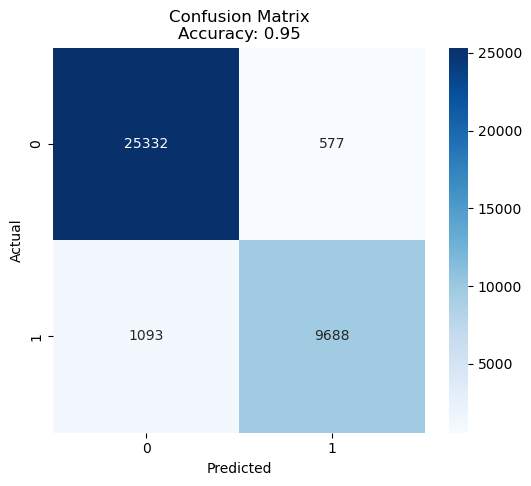

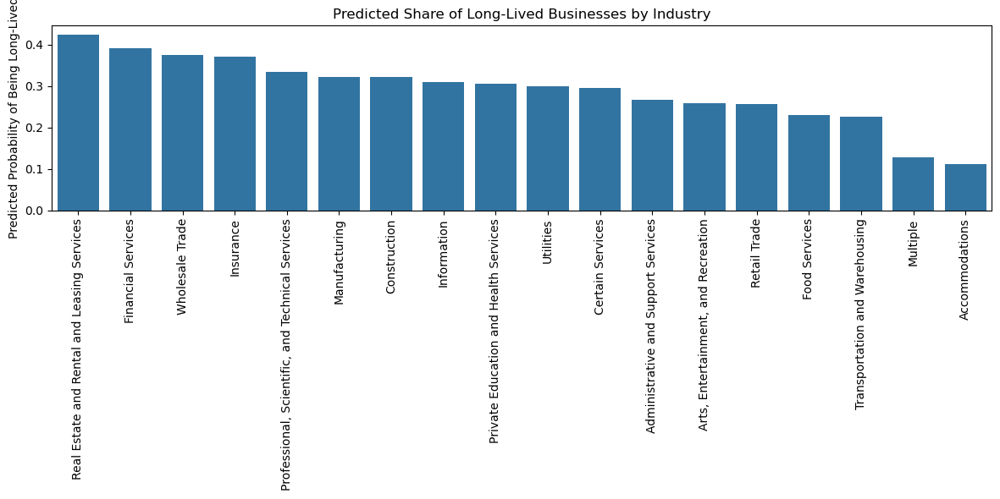

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix, accuracy_score

# Safe sigmoid
def safe_sigmoid(z):
    z = np.clip(z, -500, 500)  # Prevent overflow
    return 1 / (1 + np.exp(-z))

# Logistic regression
class ManualLogisticRegression:
    def __init__(self, lr=0.1, epochs=1000):
        self.lr = lr
        self.epochs = epochs

    def fit(self, X, y):
        self.weights = np.zeros(X.shape[1])
        self.bias = 0

        for _ in range(self.epochs):
            linear = np.dot(X, self.weights) + self.bias
            predictions = safe_sigmoid(linear)
            error = predictions - y

            dw = np.dot(X.T, error) / X.shape[0]
            db = np.mean(error)

            self.weights -= self.lr * dw
            self.bias -= self.lr * db

    def predict_proba(self, X):
        linear = np.dot(X, self.weights) + self.bias
        return safe_sigmoid(linear)

    def predict(self, X):
        return (self.predict_proba(X) >= 0.5).astype(int)

# Load and preprocess data
df = pd.read_csv("//Users//yst//Documents//02806//project//business_data_2003_2025.csv")
df["Business Start Date"] = pd.to_datetime(df["Business Start Date"], errors="coerce")
df["Business End Date"] = pd.to_datetime(df["Business End Date"], errors="coerce")
df["end_date"] = df["Business End Date"].fillna(pd.to_datetime("2025-01-01"))
df["lifespan_years"] = (df["end_date"] - df["Business Start Date"]).dt.days / 365.25
df["Start Year"] = df["Business Start Date"].dt.year
df["long_lived"] = (df["lifespan_years"] >= 10).astype(int)

df = df[["NAICS Code Description", "Neighborhoods - Analysis Boundaries", "Start Year", "long_lived"]].dropna()

# One-hot encode categorical vars
encoder = OneHotEncoder(sparse_output=False, handle_unknown="ignore")
X_cat = encoder.fit_transform(df[["NAICS Code Description", "Neighborhoods - Analysis Boundaries"]])
X_time = df[["Start Year"]].values

# Standardize Start Year
X_time = (X_time - X_time.mean()) / (X_time.std() if X_time.std() != 0 else 1)

# Combine features
X = np.hstack([X_time, X_cat])
y = df["long_lived"].values

# Train/test split and fit model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
model = ManualLogisticRegression()
model.fit(X_train, y_train)

# Model evaluation
y_pred = model.predict(X_test)
acc = accuracy_score(y_test, y_pred)
cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title(f"Confusion Matrix\nAccuracy: {acc:.2f}")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.savefig("confusion_matrix_professional.png", dpi=300)
plt.show()

# Predict long-lived rate by industry
industry_probs = []
industry_names = df["NAICS Code Description"].unique()

for industry in industry_names:
    subset = df[df["NAICS Code Description"] == industry].copy()
    if subset.shape[0] < 50:
        continue

    subset["Start Year"] = (subset["Start Year"] - df["Start Year"].mean()) / (df["Start Year"].std() if df["Start Year"].std() != 0 else 1)
    X_cat_ind = encoder.transform(subset[["NAICS Code Description", "Neighborhoods - Analysis Boundaries"]])
    X_ind = np.hstack([subset[["Start Year"]].values, X_cat_ind])

    prob = model.predict_proba(X_ind).mean()
    industry_probs.append((industry, prob))

# Plot predicted proportions
industry_probs.sort(key=lambda x: x[1], reverse=True)
industries, probs = zip(*industry_probs)

plt.figure(figsize=(12, 6))
sns.barplot(x=list(industries), y=list(probs))
plt.xticks(rotation=90)
plt.ylabel("Predicted Probability of Being Long-Lived")
plt.title("Predicted Share of Long-Lived Businesses by Industry")
plt.tight_layout()
plt.savefig("predicted_long_lived_by_industry.png", dpi=300)
plt.show()

# Data Analysis
This project aimed to explore which factors might influence the longevity of businesses in San Francisco. After cleaning and structuring the dataset, I conducted a series of visual and spatial analyses to examine three key dimensions: time, location, and industry.

**Temporal Trends**

By plotting the number of registrations and closures each year, I found that business creation steadily increased until 2018. However, closures surged around that year, likely tied to external disruptions such as wildfires <a href="#ref1">[1]</a> or the COVID-19 <a href="#ref2">[2]</a>. This suggests that timing plays a critical role in survival.

**Spatial Patterns**

Mapping business density and average lifespan by neighborhood revealed a disconnect: areas with more businesses didn’t always have longer survival times. By contract, some quieter neighborhoods—like Presidio Heights or Golden Gate Park exhibited longer average lifespans. This contrast highlights that stability doesn’t always follow foot traffic.

**Industry Longevity**

Through an interactive visualization of business lifespan distributions, I noticed that short-lived ventures were easy to spot — industries like Information had clear clusters near the bottom. However, not all patterns were so clear-cut. Some industries—like Professional, Scientific, and Technical Services had wide lifespan spreads, with both a high number of long-lived and short-lived businesses. This suggests that while the sector may appear promising at first glance, it also carries substantial risk. A summary bar chart further confirmed that some sectors consistently support long-term survival more than others, while others require a more nuanced look.

**Prediction (Machine Learning Implementation)**

To complement the exploratory analysis, I implemented a logistic regression classifier from scratch to predict the likelihood that a business survives for 10 years or more. The target variable for this model is a binary indicator named long_lived, which is set to 1 if a business has a lifespan of 10 years or more. To predict this outcome, the model uses three key features: the business’s start year (which is standardized), its industry category (NAICS Code Description), and its neighborhood (Neighborhoods - Analysis Boundaries). The latter two categorical variables are encoded using one-hot encoding to enable numerical computation. The model was trained on a 70/30 train-test split and optimized using gradient descent for 1000 epochs. The sigmoid activation was implemented with clipping to avoid numerical overflow. After training, the model achieved 95% accuracy on the test set, as shown in the confusion matrix. Finally, the trained model was used to compute the mean predicted probability of long-lived survival for each industry across all available data. This takes into account not only industry label but also when and where businesses were established, which offering more context than simple historical proportions.

These patterns suggest that external context — not just business idea plays a significant role in success. Timing, place, and industry type each contribute in different ways to the odds of endurance. I think that understanding these factors can help future entrepreneurs make more informed decisions.

# Genre <a href="#ref3">[3]</a>
This project follows an explanatory genre. The goal was to guide readers through a sequence of visual evidence — from  time trends to spatial and industrial patterns , and to help them understand how these different factors  relate to business longevity in San Francisco.
### Visual Narrative Tools
**Visual Structuring: Consistent Visual Platform:**

All visuals follow a unified style: same font, clear titles, and axis labels. This visual consistency helps the audience stay oriented while moving across different plots and formats.

**Highlighting: Feature Distinction & Zooming**

I used distinct color palettes to highlight differences — for instance, contrasting new business registrations and closures or using gradient colors to show business lifespan across neighborhoods. Some interactive plots like the maps support zooming, allowing viewers to explore specific areas or industries in greater detail. This can enhances user focus on specific features of the data without overwhelming them with the full picture all at once.

**Familiar Objects & Object Continuity**

The same core dataset is reused across multiple visualizations, which helps viewers maintain context and build familiarity. For example, the concept of business lifespan is introduced early and reappears in both the neighborhood-level and industry-level views, reinforcing continuity and aiding understanding as the story shifts perspectives.
### Narrative Structure Tools
**Ordering: Linear**

The narrative moves logically from when businesses start, to where they are located, to what kind they are — following a time–place–industry structure, which corresponding the title of the story.

**Interactivity: Hover Highlighting & Filtering / Selection / Search**

Several visualizations in the project include hover functionality. For example, in the line chart and choropleth maps, users can hover over data points or regions to view detailed values — such as the number of businesses, neighborhood names, or average lifespans. The industry lifespan visualization uses a dropdown menu for readers to select different industries. This interactive filtering allows readers to focus on the sectors most relevant or interesting to them.

**Introductory Text & Summary / Synthesis & Captions / Headlines & Accompanying Article & Multi-Messaging & Comment Repetition**

The blog begins with a personal and engaging introduction that connects a real-world observation to the motivation for the project, guiding readers smoothly into the analysis. Each chart is embedded within an explanatory narrative, offering contextual background and referenced sources — such as those on wildfires or economic recovery — so that readers can interpret the data even without prior knowledge. Throughout the blog, short, bold section titles like “Time,” “Place,” and “Industry” help guide the narrative, acting like visual anchors that make the structure intuitive. At the end, a concise summary ties together key insights about how timing, location, and industry affect business survival, reinforcing the core themes of the analysis. Several visualizations deliver more than one message — for instance, the scatter plot shows both the spread and density of business lifespans, allowing readers to explore longevity and volatility simultaneously. Important observations, such as the fact that high-density areas don’t necessarily mean longer survival, are repeated many times. This repetition helps reinforce the narrative and ensures that the main takeaways are clearly communicated.

# Visualizations
I selected a combination of static and interactive visualizations to guide readers through the story of business survival from three dimensions — time, place, and industry.

The line chart comparing yearly registrations and closures helps establish the temporal context, revealing shifts in business activity over two decades. This was essential to show how external events like wildfires and COVID-19 visibly impacted the business landscape.
The two choropleth maps — one for business density and another for average lifespan by neighborhood provide a spatial perspective. While business counts show where economic activity is concentrated, I wanted to know if those same areas also support longer survival. The lifespan map was designed to test whether high density correlates with long-term stability. They allow readers to quickly see geographic variation, and together they challenge assumptions (e.g., high density doesn’t always mean longevity).

To explore industry differences, I used a Bokeh-based interactive scatter plot that lets users switch between sectors. This enables a more nuanced understanding of how survival patterns vary by field and encourages exploration beyond a single static view. A bar chart then summarizes the proportion of long-lived businesses in each sector to reinforce those insights. 

In the final part of the project, I incorporated a machine learning–based prediction. A confusion matrix was used to evaluate the model’s accuracy in identifying whether a business would survive at least 10 years. The matrix helps demonstrate the model’s reliability and supports the use of its output in further analysis. Based on this model, I generated a prediction bar chart to estimate the probability of long-lived businesses in each industry. While it may visually resemble the earlier industry chart, this visualization is based on model-generated probabilities and accounts for interactions between time, location, and industry, which offering a more forward-looking, integrated perspective.

Together, these visualizations were chosen not just for their readability, but because they align with the three-part structure of the story, which showing how time, place, and industry all shape a business’s odds of survival, and how these dimensions can be combined in a predictive framework.

# Discussion
One of the strengths of this project lies in its structured, three-part narrative. By breaking the analysis into time, location, and industry, the story becomes more approachable, which allowing readers to engage with a complex dataset without feeling overwhelmed. The combination of static and interactive visualizations helped strike a balance between clarity and flexibility: for instance, the Bokeh scatterplot invited users to explore survival patterns across different industries, while maps and line charts provided broader overviews. The other is real-world context — such as references to wildfires and COVID-19, which added relevance to the data and connected trends to lived experience. Meanwhile, the machine learning component added an additional layer of insight, showing how these three factors could be used together to predict long-term business survival. The model-driven visualization based on predicted probabilities gave a forward-looking perspective, complementing the descriptive charts built on historical data.

That said, the analysis remains largely factor-separated. Each dimension (time, place, and industry) was explored in isolation. What I hope to pursue in future work is a closer examination of interactions between them. For example, are certain industries more resilient in specific neighborhoods? Do businesses started during economic downturns fare differently depending on location or sector? These cross-dimensional dynamics are likely key to a more complete understanding of business longevity.

This project served as a foundation, offering clear patterns and predictive insight. I will consider a follow-up notebook or blog post that dives into these layered questions more deeply.

# Contributions
Shuting Yang (s242645): Contributed 100% in this project.

# <h3 id="ref1">References</h3>
<p id="ref1">[1] San Francisco Business Times. <i>Bay Area air quality hits dangerous levels as smoke from Camp Fire spreads</i>. 2018. <a href="https://www.bizjournals.com/sanfrancisco/news/2018/11/16/bay-area-air-quality-danger-levels-camp-fire.html" target="_blank">Link</a></p>

<p id="ref2">[2] San Francisco Office of Economic and Workforce Development. <i>2020 Small Business Survey Report</i>. 2020. <a href="https://media.api.sf.gov/documents/2020_Small_Business_Survey_Report.pdf" target="_blank">Link</a></p>

<p id="ref3">[3] Segel, E., & Heer, J. (2010). <i>“Narrative Visualization: Telling Stories with Data”</i>. IEEE Transactions on Visualization and Computer Graphics, 16(6), 1139–1148. <a href="https://doi.org/10.1109/TVCG.2010.179" target="_blank">Link</a></p>